In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines){return false;}

<IPython.core.display.Javascript object>

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
import tensorflow as tf
import imghdr
from PIL import Image
%load_ext watermark

In [4]:
%watermark -iv -v -m -u

pandas      0.22.0
numpy       1.14.0
cv2.cv2     3.4.1
tensorflow  1.8.0
last updated: 

CPython 3.6.4
IPython 6.2.1

compiler   : GCC 7.2.0
system     : Linux
release    : 4.4.0-130-generic
machine    : x86_64
processor  : x86_64
CPU cores  : 8
interpreter: 64bit


For this project, OpenCV will be utilized with python and Video/Image processing. It is also available for C++. OpenCV has great documentation that can be seen [here](https://opencv.org/). First, we will walk through the steps of Video processing and analysis. If you cloned this repository, you'll notice there's no associated video file. Github has a size limit on repos and uploading a video would exceed this limit. You can however substitute your own video and run this code. I will display the video frames inline for illustrative purposes, but will also leave code for you to execute to actually playback a video file

The goal for this project is to successfully detect objects in images. The same concepts could be applied to object detection in videos. This will be achieved by feeding images through a Convolutional Neural Network. Also, A video is just a bunch of image frames flashed across the screen really fast in succession. Each frame of the video is analyzed one by one. Let's analyze frames in a video

In [5]:
video = 'Turtle.mp4'

The first thing we need to do is set the video as an OpenCV object

In [6]:
cap = cv2.VideoCapture(video)

Now that we have the video object, we can learn a few things about the video. Using the .get() method, we can pass an integer values corresponding to one of the 0-index items in the following list to retrieve the information:

0. CAP_PROP_POS_MSEC Current position of the video file in milliseconds or video capture timestamp.
1. CAP_PROP_POS_FRAMES 0-based index of the frame to be decoded/captured next.
2. CAP_PROP_POS_AVI_RATIO Relative position of the video file: 0 - start of the film, 1 - end of the film.
3. CAP_PROP_FRAME_WIDTH Width of the frames in the video stream.
4. CAP_PROP_FRAME_HEIGHT Height of the frames in the video stream.
5. CAP_PROP_FPS Frame rate.
6. CAP_PROP_FOURCC 4-character code of codec.
7. CAP_PROP_FRAME_COUNT Number of frames in the video file.
8. CAP_PROP_FORMAT Format of the Mat objects returned by retrieve() .
9. CAP_PROP_MODE Backend-specific value indicating the current capture mode.
10. CAP_PROP_BRIGHTNESS Brightness of the image (only for cameras).
11. CAP_PROP_CONTRAST Contrast of the image (only for cameras).
12. CAP_PROP_SATURATION Saturation of the image (only for cameras).
13. CAP_PROP_HUE Hue of the image (only for cameras).
14. CAP_PROP_GAIN Gain of the image (only for cameras).
15. CAP_PROP_EXPOSURE Exposure (only for cameras).
16. CAP_PROP_CONVERT_RGB Boolean flags indicating whether images should be converted to RGB.
17. CAP_PROP_WHITE_BALANCE Currently not supported
18. CAP_PROP_RECTIFICATION Rectification flag for stereo cameras (note: only supported by DC1394 v 2.x backend currently)

Remember it is 0-index. So number 1 in the list is number 0 in python

In [7]:
print('Total Number of Frames: {}'.format(int(cap.get(7))))
print('Video Playback Speed: {}fps'.format(int(cap.get(5))))
print('Video Resolution: {} x {}'.format(int(cap.get(4)), int(cap.get(3))))
print('Video Playback Lenght: {}s'.format(int(cap.get(7) / cap.get(5))))

Total Number of Frames: 323
Video Playback Speed: 29fps
Video Resolution: 720 x 1280
Video Playback Lenght: 11s


So we can see the video is 11 seconds in lenght with 323 total frames and a playback speed of 29 frames per second. The Resolution of the video is 720 x 1280. This means that it is 720 pixels high and 1280 pixels wide. One thing to note about pixels; a single pixel consists of 3 colors: red, green, blue, or RGB. So for every pixel in a given frame of the video (720 X 1280 = 921,600 pixels) there are 3 values associated with each pixel; an R-red, G-green, and B-blue. So we can think of a frame as a 3D cube with dimension 720H X 1280W x 3D (height, width, and depth). In the computer vision world, the depth dimension is referred to as the "channel" of the image. So these frames have 3 channels (being RGB). Let's extract the first frame of the video and explore it's shape

In [8]:
_ , frame = cap.read()
print(frame.shape)

(720, 1280, 3)


To play your video, run the following code

In [9]:
if (cap.isOpened()== False): 
    print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()
    if ret == True:
 
        # Display the resulting frame
        cv2.imshow('Your Video',frame)
 
    # Press Q on keyboard to  exit
        if cv2.waitKey(25) & 0xFF == ord('q'):
            break
 
  # Break the loop
    else: 
        break

#When everything done, release the video capture object
cap.release()
 
# Closes all the frames
cv2.destroyAllWindows()

For illustrative purposes, since you can't see me run my video, I'll print out each frame of the video. Just scroll down really fast =). But before I do this, one thing to note. The standard convention in Video is pixel values RGB. OpenCV however does BGR. So when displaying a single image or a single frame from a video, it must be converted. For example

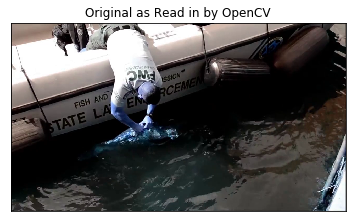

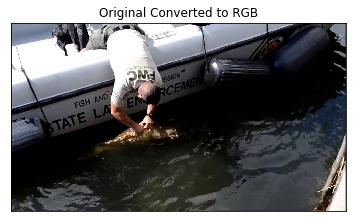

In [10]:
cap = cv2.VideoCapture(video)
cap.set(1, 1)


#Original image as read in as bgr
_, frame = cap.read()
plt.imshow(frame)
plt.title('Original as Read in by OpenCV')
plt.xticks([])
plt.yticks([])
plt.show()


#convert the frame from BGR to RGB
rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)


#converted back to rgb
plt.imshow(rgb)
plt.title('Original Converted to RGB')
plt.xticks([])
plt.yticks([])
plt.show()


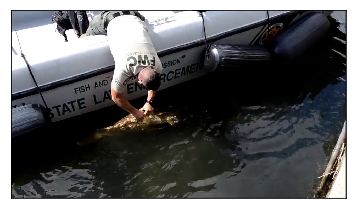

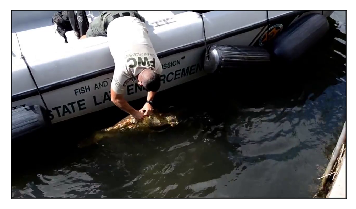

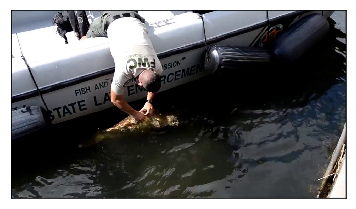

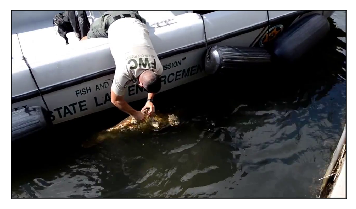

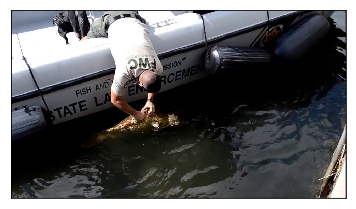

...

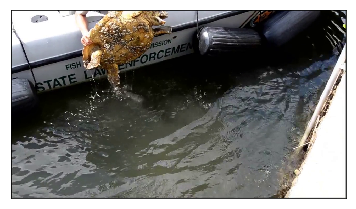

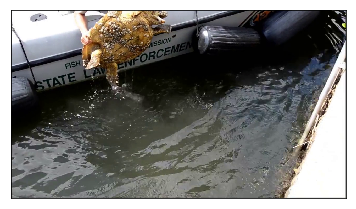

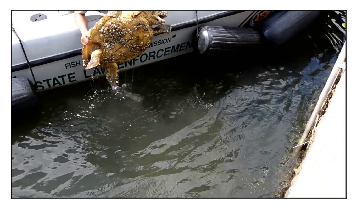

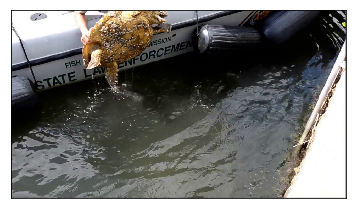

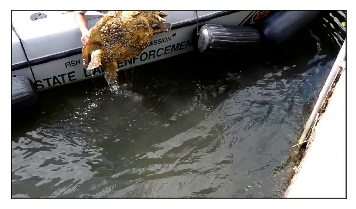

In [11]:
cap = cv2.VideoCapture(video)
for i in range(int(cap.get(7))):
    cap.set(1, i)
    _ , frame = cap.read()
    
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    plt.imshow(frame)
    plt.xticks([])
    plt.yticks([])
    plt.show()

### Converting to Grayscale

Not only can you convert between RGB and BGR, but OpenCV can also convert to grayscale. This is a common practice in processing image files due to how computationally inexpensive it is. When dealing with RGB or BGR, using these images for example, you're dealing with (270 x 1280 x 3) pixels. When converting to grayscale, the pixels are represented as a single value ranging from 0 to 255. A value of 0 is black where 255 is white. So the 3 dimensional array of pixes is reduced by a dimension of 1 to (270 x 1280 x 1)

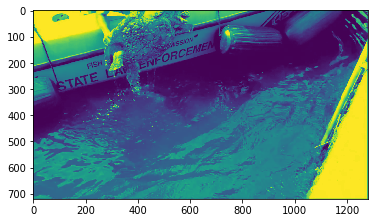

Shape of image: (720, 1280)


In [12]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) 
plt.imshow(gray)
plt.show()

print('Shape of image: {}'.format(gray.shape))